# Série Temporal do Clima na região de **Petrolina-PE**
Uma série temporal é definida como um conjunto de observações registradas ao longo do tempo, organizadas de forma **cronológica**. Esse tipo de análise permite identificar **padrões**, **tendências** e ciclos que podem surgir em diversos contextos, como economia, saúde, e, especialmente, no campo da meteorologia.

O estudo de variáveis meteorológicas, como a precipitação, tem ganhado cada vez mais destaque devido à crescente importância de compreender os impactos das mudanças climáticas. Com o aumento da frequência e intensidade dos eventos climáticos extremos, como secas, inundações e tempestades severas, o monitoramento e a análise detalhada dessas séries temporais tornam-se ferramentas essenciais para prever e mitigar possíveis desastres naturais. Além disso, esses estudos permitem uma melhor compreensão das dinâmicas climáticas em longo prazo, auxiliando na formulação de políticas públicas voltadas para a adaptação e mitigação das consequências dessas alterações no clima global.

In [1]:
using CSV, DataFrames, StatsPlots, Dates, Plots, StatsBase, GLM
theme(:wong)

In [2]:
readdir()

38-element Vector{String}:
 "INMET.ipynb"
 "INMET_NE_PE_A307_PETROLINA_01-01-2004_A_31-12-2004.CSV"
 "INMET_NE_PE_A307_PETROLINA_01-01-2005_A_31-12-2005.CSV"
 "INMET_NE_PE_A307_PETROLINA_01-01-2006_A_31-12-2006.CSV"
 "INMET_NE_PE_A307_PETROLINA_01-01-2007_A_31-12-2007.CSV"
 "INMET_NE_PE_A307_PETROLINA_01-01-2008_A_31-12-2008.CSV"
 "INMET_NE_PE_A307_PETROLINA_01-01-2009_A_31-12-2009.CSV"
 "INMET_NE_PE_A307_PETROLINA_01-01-2010_A_31-12-2010.CSV"
 "INMET_NE_PE_A307_PETROLINA_01-01-2011_A_31-12-2011.CSV"
 "INMET_NE_PE_A307_PETROLINA_01-01-2012_A_31-12-2012.CSV"
 ⋮
 "kmeans.ipynb"
 "questões_de_concursos.ipynb"
 "regressao_linear.ipynb"
 "shapley_value.ipynb"
 "src copy.html"
 "src copy.ipynb"
 "src_plotlyjs.ipynb"
 "subplots_temperatura_mensal.png"
 "subplots_temperatura_mensal_sem_xlabel.png"

In [2]:
# Lista de arquivos CSV
arquivos_csv = [
    "INMET_NE_PE_A307_PETROLINA_21-02-2003_A_31-12-2003.CSV",
    "INMET_NE_PE_A307_PETROLINA_01-01-2004_A_31-12-2004.CSV",
    "INMET_NE_PE_A307_PETROLINA_01-01-2005_A_31-12-2005.CSV",
    "INMET_NE_PE_A307_PETROLINA_01-01-2006_A_31-12-2006.CSV",
    "INMET_NE_PE_A307_PETROLINA_01-01-2007_A_31-12-2007.CSV",
    "INMET_NE_PE_A307_PETROLINA_01-01-2008_A_31-12-2008.CSV",
    "INMET_NE_PE_A307_PETROLINA_01-01-2009_A_31-12-2009.CSV",
    "INMET_NE_PE_A307_PETROLINA_01-01-2010_A_31-12-2010.CSV",
    "INMET_NE_PE_A307_PETROLINA_01-01-2011_A_31-12-2011.CSV",
    "INMET_NE_PE_A307_PETROLINA_01-01-2012_A_31-12-2012.CSV",
    "INMET_NE_PE_A307_PETROLINA_01-01-2013_A_31-12-2013.CSV",
    "INMET_NE_PE_A307_PETROLINA_01-01-2014_A_31-12-2014.CSV",
    "INMET_NE_PE_A307_PETROLINA_01-01-2015_A_31-12-2015.CSV",
    "INMET_NE_PE_A307_PETROLINA_01-01-2016_A_31-12-2016.CSV",
    "INMET_NE_PE_A307_PETROLINA_01-01-2017_A_31-12-2017.CSV",
    "INMET_NE_PE_A307_PETROLINA_01-01-2018_A_31-12-2018.CSV",
    "INMET_NE_PE_A307_PETROLINA_01-01-2019_A_31-12-2019.CSV",
    "INMET_NE_PE_A307_PETROLINA_01-01-2020_A_31-12-2020.CSV",
    "INMET_NE_PE_A307_PETROLINA_01-01-2021_A_31-12-2021.CSV",
    "INMET_NE_PE_A307_PETROLINA_01-01-2022_A_31-12-2022.CSV",
    "INMET_NE_PE_A307_PETROLINA_01-01-2023_A_31-12-2023.CSV",
    "INMET_NE_PE_A307_PETROLINA_01-01-2024_A_31-12-2024.CSV",
]

# Função para renomear as colunas pela sua sequência numérica
function renomear_colunas(df::DataFrame)
    nomes_novos = ["col_$i" for i in 1:ncol(df)]  # Gerar nomes 'col_1', 'col_2', etc.
    rename!(df, nomes_novos)
end

renomear_colunas (generic function with 1 method)

In [3]:
# Dicionário de renomeação das colunas
dicionario_renomeacao = Dict(
    "col_1" => :DATA,
    "col_2" => :HORA,
    "col_3" => :PRECIP_mm,
    "col_4" => :PRESSAO_ATMOSFERICA_NIVEL_ESTACAO_mb,
    "col_5" => :PRESSAO_ATMOSFERICA_MAX_mb,
    "col_6" => :PRESSAO_ATMOSFERICA_MIN_mb,
    "col_7" => :RADIACAO_GLOBAL_kjm2,
    "col_8" => :TEMPERATURA_AR_BULBO_SECO,
    "col_9" => :TEMPERATURA_PONTO_DE_ORVALHO,
    "col_10" => :TEMPERATURA_MAXIMA,
    "col_11" => :TEMPERATURA_MINIMA,
    "col_12" => :TEMPERATURA_ORVALHO_MAX,
    "col_13" => :TEMPERATURA_ORVALHO_MIN,
    "col_14" => :UMIDADE_RELATIVA_MAXIMA_percent,
    "col_15" => :UMIDADE_RELATIVA_MINIMA_percent,
    "col_16" => :UMIDADE_RELATIVA_AR_percent,
    "col_17" => :VENTO_DIRECAO,
    "col_18" => :VENTO_RAJADA_MAXIMA_ms,
    "col_19" => :VENTO_VELOCIDADE_ms
)

Dict{String, Symbol} with 19 entries:
  "col_12" => :TEMPERATURA_ORVALHO_MAX
  "col_13" => :TEMPERATURA_ORVALHO_MIN
  "col_7"  => :RADIACAO_GLOBAL_kjm2
  "col_15" => :UMIDADE_RELATIVA_MINIMA_percent
  "col_1"  => :DATA
  "col_10" => :TEMPERATURA_MAXIMA
  "col_6"  => :PRESSAO_ATMOSFERICA_MIN_mb
  "col_8"  => :TEMPERATURA_AR_BULBO_SECO
  "col_14" => :UMIDADE_RELATIVA_MAXIMA_percent
  "col_19" => :VENTO_VELOCIDADE_ms
  "col_3"  => :PRECIP_mm
  "col_18" => :VENTO_RAJADA_MAXIMA_ms
  "col_4"  => :PRESSAO_ATMOSFERICA_NIVEL_ESTACAO_mb
  "col_11" => :TEMPERATURA_MINIMA
  "col_9"  => :TEMPERATURA_PONTO_DE_ORVALHO
  "col_16" => :UMIDADE_RELATIVA_AR_percent
  "col_17" => :VENTO_DIRECAO
  "col_2"  => :HORA
  "col_5"  => :PRESSAO_ATMOSFERICA_MAX_mb

In [4]:
# Função para renomear as colunas de acordo com o dicionário
function renomear_colunas_dicionario(df::DataFrame, dicionario::Dict)
    rename!(df, dicionario)
end

renomear_colunas_dicionario (generic function with 1 method)

In [5]:
# Carregar todos os CSVs, renomear as colunas sequenciais e aplicar o dicionário de renomeação
df = vcat([renomear_colunas_dicionario(renomear_colunas(CSV.read(arquivo, DataFrame; delim=';')), dicionario_renomeacao) for arquivo in arquivos_csv]...)

Row,DATA,HORA,PRECIP_mm,PRESSAO_ATMOSFERICA_NIVEL_ESTACAO_mb,PRESSAO_ATMOSFERICA_MAX_mb,PRESSAO_ATMOSFERICA_MIN_mb,RADIACAO_GLOBAL_kjm2,TEMPERATURA_AR_BULBO_SECO,TEMPERATURA_PONTO_DE_ORVALHO,TEMPERATURA_MAXIMA,TEMPERATURA_MINIMA,TEMPERATURA_ORVALHO_MAX,TEMPERATURA_ORVALHO_MIN,UMIDADE_RELATIVA_MAXIMA_percent,UMIDADE_RELATIVA_MINIMA_percent,UMIDADE_RELATIVA_AR_percent,VENTO_DIRECAO,VENTO_RAJADA_MAXIMA_ms,VENTO_VELOCIDADE_ms
,String15,Any,String7?,String7?,String7?,String7?,Any,String7?,String7?,String7?,String7?,String7?,String7?,Int64?,Int64?,Int64?,Int64?,String7?,String7?
1,21/02/2003,00:00:00,-9999,-9999,-9999,-9999,-9999,-9999,-9999,-9999,-9999,-9999,-9999,-9999,-9999,-9999,-9999,-9999,-9999
2,21/02/2003,01:00:00,-9999,-9999,-9999,-9999,-9999,-9999,-9999,-9999,-9999,-9999,-9999,-9999,-9999,-9999,-9999,-9999,-9999
3,21/02/2003,02:00:00,-9999,-9999,-9999,-9999,-9999,-9999,-9999,-9999,-9999,-9999,-9999,-9999,-9999,-9999,-9999,-9999,-9999
4,21/02/2003,03:00:00,-9999,-9999,-9999,-9999,-9999,-9999,-9999,-9999,-9999,-9999,-9999,-9999,-9999,-9999,-9999,-9999,-9999
5,21/02/2003,04:00:00,-9999,-9999,-9999,-9999,-9999,-9999,-9999,-9999,-9999,-9999,-9999,-9999,-9999,-9999,-9999,-9999,-9999
6,21/02/2003,05:00:00,-9999,-9999,-9999,-9999,-9999,-9999,-9999,-9999,-9999,-9999,-9999,-9999,-9999,-9999,-9999,-9999,-9999
7,21/02/2003,06:00:00,-9999,-9999,-9999,-9999,-9999,-9999,-9999,-9999,-9999,-9999,-9999,-9999,-9999,-9999,-9999,-9999,-9999
8,21/02/2003,07:00:00,-9999,-9999,-9999,-9999,-9999,-9999,-9999,-9999,-9999,-9999,-9999,-9999,-9999,-9999,-9999,-9999,-9999
9,21/02/2003,08:00:00,-9999,-9999,-9999,-9999,-9999,-9999,-9999,-9999,-9999,-9999,-9999,-9999,-9999,-9999,-9999,-9999,-9999


In [6]:
# Converter a coluna DATA para o tipo Date
df.DATA = Date.(df.DATA, "dd/mm/yyyy")

191640-element Vector{Date}:
 2003-02-21
 2003-02-21
 2003-02-21
 2003-02-21
 2003-02-21
 2003-02-21
 2003-02-21
 2003-02-21
 2003-02-21
 2003-02-21
 ⋮
 2024-12-31
 2024-12-31
 2024-12-31
 2024-12-31
 2024-12-31
 2024-12-31
 2024-12-31
 2024-12-31
 2024-12-31

In [8]:
describe(df)

Row,variable,mean,min,median,max,nmissing,eltype
,Symbol,Union…,Any,Any,Any,Int64,Type
1,DATA,,2003-02-21,2014-01-26,2024-12-31,0,Date
2,HORA,,,,,0,Any
3,PRECIP_mm,,-9999,,"9,8",11768,"Union{Missing, String7}"
4,PRESSAO_ATMOSFERICA_NIVEL_ESTACAO_mb,,-9999,,"980,7",11695,"Union{Missing, String7}"
5,PRESSAO_ATMOSFERICA_MAX_mb,,-9999,,"980,8",11696,"Union{Missing, String7}"
6,PRESSAO_ATMOSFERICA_MIN_mb,,-9999,,"980,5",11696,"Union{Missing, String7}"
7,RADIACAO_GLOBAL_kjm2,,,,,35916,Any
8,TEMPERATURA_AR_BULBO_SECO,,-9999,,"40,9",11695,"Union{Missing, String7}"
9,TEMPERATURA_PONTO_DE_ORVALHO,,-9999,,"9,9",11699,"Union{Missing, String7}"


In [15]:
using MissingPatterns

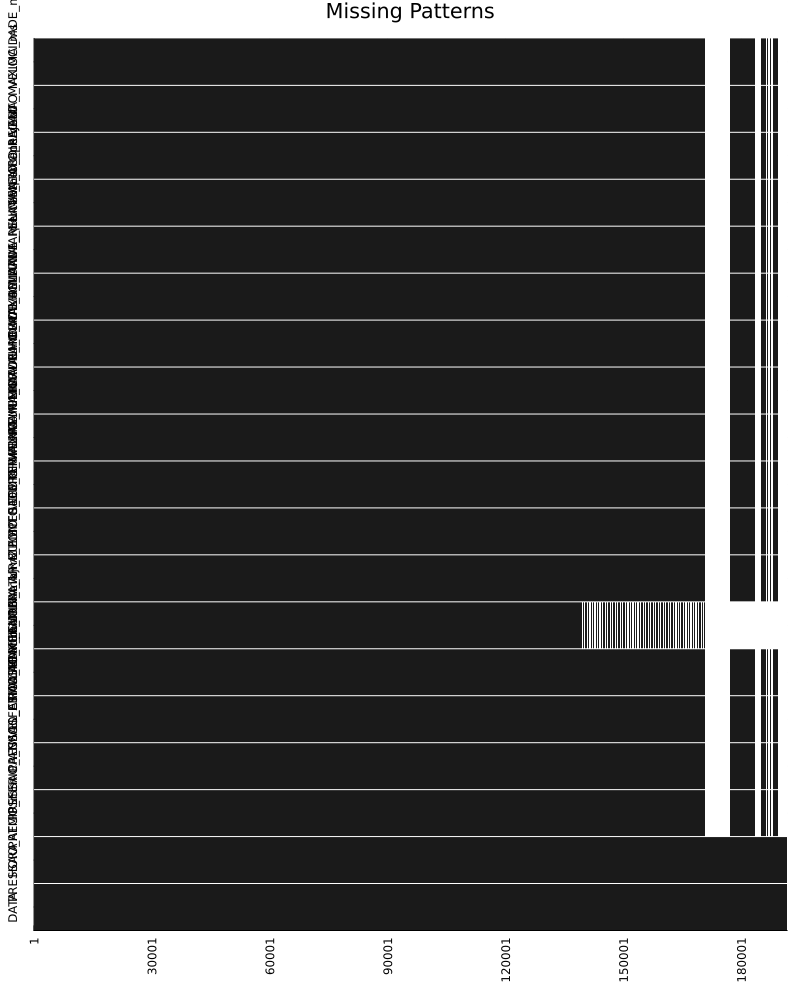

In [23]:
plotmissing(df, orientation=:horizontal, tick_step=30000)

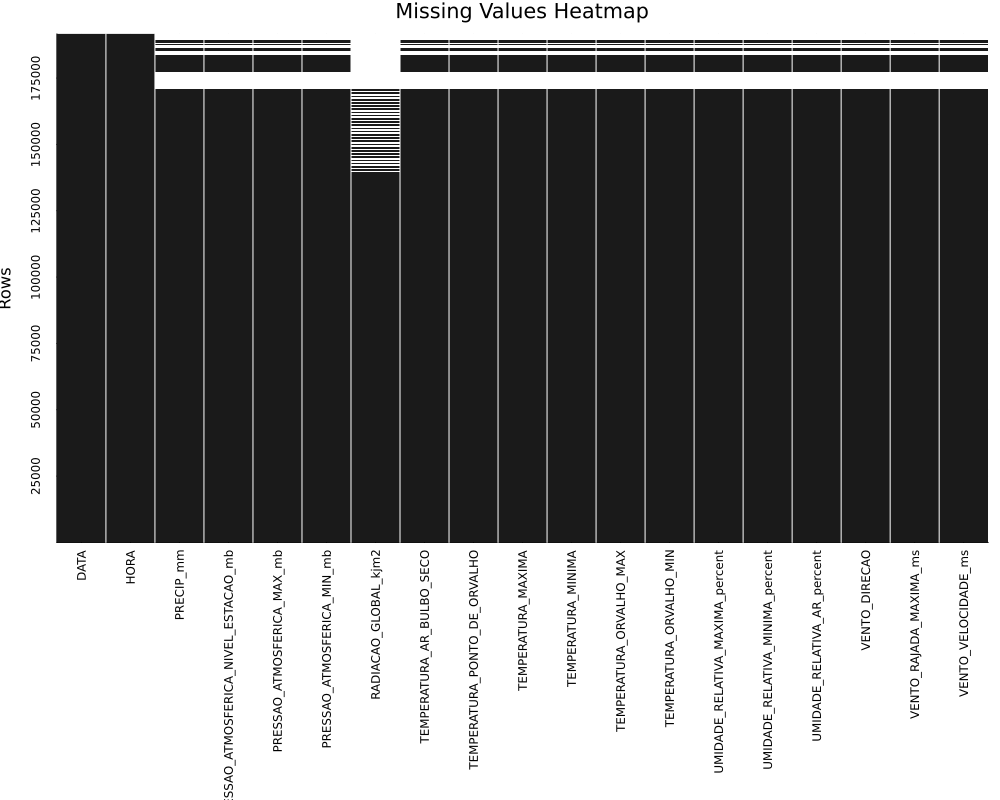

In [9]:
# Converter os valores ausentes em uma matriz booleana
missing_values = Matrix{Bool}(ismissing.(df))

# Criar o mapa de calor
p = heatmap(missing_values, 
            xlabel="Columns", ylabel="Rows", 
            title="Missing Values Heatmap", 
            colorbar=false,  # Remover a legenda (barra de cores)
            color=cgrad([:grey10, :white]),  # Escala de cores em preto e branco
            xticks=(1:size(missing_values, 2), names(df)),  # Adicionar os nomes das colunas no xtick
            rotation=90,  # Rotacionar os rótulos das colunas
            formatter=:plain,
            size=(1000, 800))  # Aumentar a resolução do gráfico

# Adicionar linhas verticais entre as colunas
for x in 1.5:1:(size(missing_values, 2) - 0.5)
    vline!([x], linecolor=:white, linewidth=1, label="")
end

display(p)

In [10]:
# Remover as linhas que contém valores Missing
df = dropmissing(df)

Row,DATA,HORA,PRECIP_mm,PRESSAO_ATMOSFERICA_NIVEL_ESTACAO_mb,PRESSAO_ATMOSFERICA_MAX_mb,PRESSAO_ATMOSFERICA_MIN_mb,RADIACAO_GLOBAL_kjm2,TEMPERATURA_AR_BULBO_SECO,TEMPERATURA_PONTO_DE_ORVALHO,TEMPERATURA_MAXIMA,TEMPERATURA_MINIMA,TEMPERATURA_ORVALHO_MAX,TEMPERATURA_ORVALHO_MIN,UMIDADE_RELATIVA_MAXIMA_percent,UMIDADE_RELATIVA_MINIMA_percent,UMIDADE_RELATIVA_AR_percent,VENTO_DIRECAO,VENTO_RAJADA_MAXIMA_ms,VENTO_VELOCIDADE_ms
,Date,Any,String7,String7,String7,String7,Any,String7,String7,String7,String7,String7,String7,Int64,Int64,Int64,Int64,String7,String7
1,2003-02-21,00:00:00,-9999,-9999,-9999,-9999,-9999,-9999,-9999,-9999,-9999,-9999,-9999,-9999,-9999,-9999,-9999,-9999,-9999
2,2003-02-21,01:00:00,-9999,-9999,-9999,-9999,-9999,-9999,-9999,-9999,-9999,-9999,-9999,-9999,-9999,-9999,-9999,-9999,-9999
3,2003-02-21,02:00:00,-9999,-9999,-9999,-9999,-9999,-9999,-9999,-9999,-9999,-9999,-9999,-9999,-9999,-9999,-9999,-9999,-9999
4,2003-02-21,03:00:00,-9999,-9999,-9999,-9999,-9999,-9999,-9999,-9999,-9999,-9999,-9999,-9999,-9999,-9999,-9999,-9999,-9999
5,2003-02-21,04:00:00,-9999,-9999,-9999,-9999,-9999,-9999,-9999,-9999,-9999,-9999,-9999,-9999,-9999,-9999,-9999,-9999,-9999
6,2003-02-21,05:00:00,-9999,-9999,-9999,-9999,-9999,-9999,-9999,-9999,-9999,-9999,-9999,-9999,-9999,-9999,-9999,-9999,-9999
7,2003-02-21,06:00:00,-9999,-9999,-9999,-9999,-9999,-9999,-9999,-9999,-9999,-9999,-9999,-9999,-9999,-9999,-9999,-9999,-9999
8,2003-02-21,07:00:00,-9999,-9999,-9999,-9999,-9999,-9999,-9999,-9999,-9999,-9999,-9999,-9999,-9999,-9999,-9999,-9999,-9999
9,2003-02-21,08:00:00,-9999,-9999,-9999,-9999,-9999,-9999,-9999,-9999,-9999,-9999,-9999,-9999,-9999,-9999,-9999,-9999,-9999


##### Explicação das Correções:
1. **Conversão para *String*:**

- Usamos string(valor) para garantir que todos os valores sejam convertidos para strings antes de aplicar replace.

- Isso resolve o problema com tipos como *String7*.

2. **Substituição e Conversão:**

- Aplicamos `replace(string(valor), "," => ".")` para substituir vírgulas por pontos.

- Usamos `parse(Float64, ...)` para converter os valores resultantes para Float64.

3. **Verificação de Tipo:**

- A função `substituir_virgulas_por_pontos` verifica se o valor é do tipo *String* ou *String7* antes de aplicar a substituição.

- Valores que não são strings (como números inteiros) são mantidos inalterados.

In [11]:
# Função para substituir vírgulas por pontos em valores que são strings
function substituir_virgulas_por_pontos(valor)
    # Converte o valor para string, substitui vírgulas por pontos e tenta converter para Float64
    if valor isa Union{String, String7}
        return parse(Float64, replace(string(valor), "," => "."))
    else
        return valor
    end
end

# Aplicar a função a todas as colunas do DataFrame
for col in names(df)
    df[!, col] = substituir_virgulas_por_pontos.(df[!, col])
end

In [12]:
println("Número de linhas antes da remoção: ", nrow(df))
df = DataFrame(filter(row -> all(x -> !(ismissing(x) || x == -9999), row), eachrow(df)))
println("Número de linhas após a remoção: ", nrow(df))

Número de linhas antes da remoção: 155724
Número de linhas após a remoção: 77811


In [13]:
describe(df)

Row,variable,mean,min,median,max,nmissing,eltype
,Symbol,Union…,Any,Any,Any,Int64,DataType
1,DATA,,2003-02-21,2013-12-10,2022-08-10,0,Date
2,HORA,,,,,0,Any
3,PRECIP_mm,0.0458701,0.0,0.0,47.4,0,Float64
4,PRESSAO_ATMOSFERICA_NIVEL_ESTACAO_mb,970.901,961.7,970.9,980.7,0,Float64
5,PRESSAO_ATMOSFERICA_MAX_mb,971.312,961.8,971.3,980.8,0,Float64
6,PRESSAO_ATMOSFERICA_MIN_mb,970.676,961.6,970.7,980.5,0,Float64
7,RADIACAO_GLOBAL_kjm2,3296.59,0.0,1516.6,50086.0,0,Real
8,TEMPERATURA_AR_BULBO_SECO,28.5658,17.4,28.8,39.0,0,Float64
9,TEMPERATURA_PONTO_DE_ORVALHO,15.5508,1.0,15.8,23.6,0,Float64


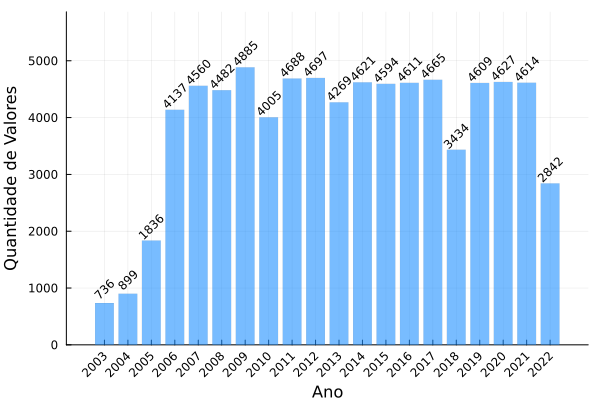

In [14]:
# Extrair o ano de cada data
df.ANO = year.(df.DATA)

# Contar a quantidade de valores por ano
contagem_por_ano = combine(groupby(df, :ANO), nrow => :QUANTIDADE)

# Ordenar o DataFrame por ano (opcional, mas útil para visualização)
sort!(contagem_por_ano, :ANO)

# Criar o gráfico de barras
bar(contagem_por_ano.ANO, 
    contagem_por_ano.QUANTIDADE, 
    xlabel="Ano", 
    ylabel="Quantidade de Valores", 
    title="", 
    legend=false, 
    color=:dodgerblue, 
    alpha=0.6,
    lw=0,
    xticks=contagem_por_ano.ANO,  # Garantir que todos os anos apareçam no eixo x
    xrotation=45,  # Rotacionar os rótulos do eixo x para melhor legibilidade
    ylim=(0, maximum(contagem_por_ano.QUANTIDADE) * 1.2))  # Ajustar o limite superior do eixo y

# Adicionar os valores em cima de cada barra com rotação
for (i, quantidade) in enumerate(contagem_por_ano.QUANTIDADE)
    annotate!(contagem_por_ano.ANO[i], quantidade + 0.05 * maximum(contagem_por_ano.QUANTIDADE), 
              text("$quantidade", :center, 8, rotation=45))  # Rotacionar o texto em 45 graus
end

# Exibir o gráfico
plot!()

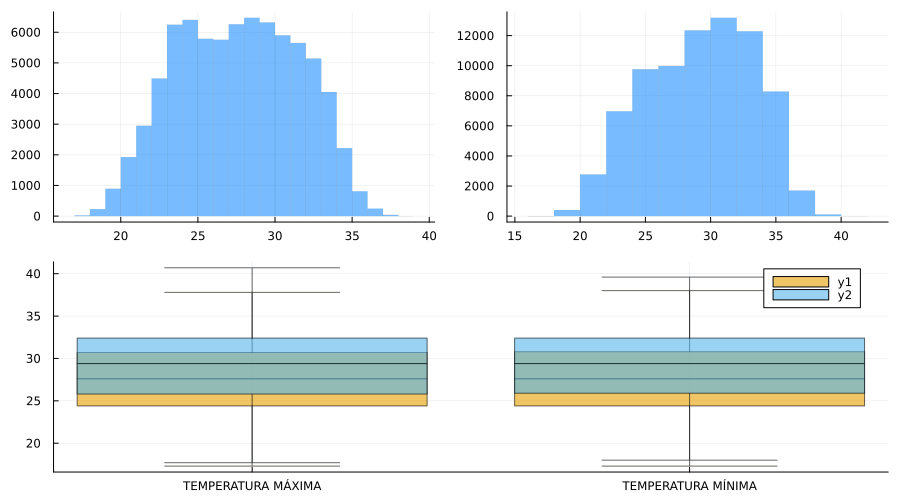

In [15]:
# Definir os dados para os plots
df_temperatura_minima = df[!, :TEMPERATURA_MINIMA]
df_temperatura_maxima = df[!, :TEMPERATURA_MAXIMA]

# Ajustar o número de bins para os histogramas
p1 = histogram(df_temperatura_minima, bins = 20, alpha=0.6, color = :dodgerblue, lw = 0, title = "Distribuição da Temperatura Mínima", legend=:none)
p2 = histogram(df_temperatura_maxima, bins = 20, alpha=0.6, color = :dodgerblue, lw = 0, title = "Distribuição da Temperatura Máxima", legend=:none)
p3 = boxplot(["TEMPERATURA MÍNIMA", "TEMPERATURA MÁXIMA"], [df_temperatura_minima, df_temperatura_maxima], alpha=0.6, title = "Boxplot das Temperaturas")

# Definir o layout com 3 plots
layout = @layout([a b; c])

# Juntar os gráficos e adicionar o título principal
plot(p1, p2, p3, layout = layout, size = (900, 500), title = "", titlefontsize = 10, formatter = :plain, widen=true)


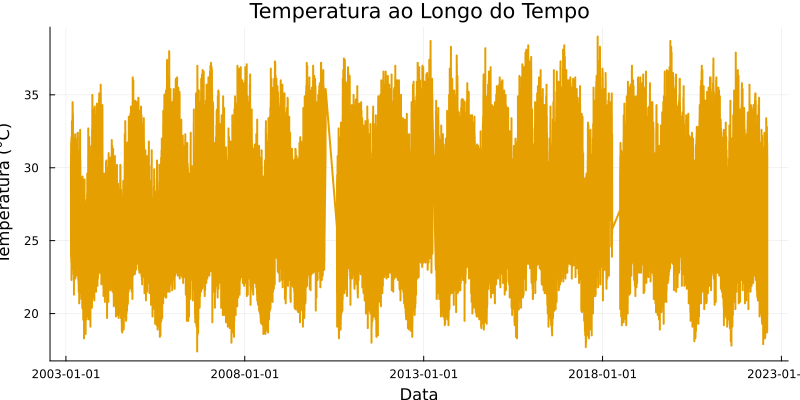

In [16]:
# Criar o gráfico
plot(df.DATA, df.TEMPERATURA_AR_BULBO_SECO,
     title = "Temperatura ao Longo do Tempo",
     xlabel = "Data",
     ylabel = "Temperatura (°C)",
     legend = false,
     lw = 2,
     size = (800, 400))    # Ajustar o tamanho (largura, altura))  # lw define a espessura da linha


In [17]:
# Média
media = mean(df.TEMPERATURA_AR_BULBO_SECO)
# Mediana
mediana = median(df.TEMPERATURA_AR_BULBO_SECO)
# Moda (usando a função mode de StatsBase)
moda = mode(df.TEMPERATURA_AR_BULBO_SECO)
# Variância
variancia = var(df.TEMPERATURA_AR_BULBO_SECO)
# Desvio padrão
desvio_padrao = std(df.TEMPERATURA_AR_BULBO_SECO)
# Coeficiente de variação
coef_variacao = (desvio_padrao / media) * 100
# Amplitude (diferença entre o maior e o menor valor)
amplitude = maximum(df.TEMPERATURA_AR_BULBO_SECO) - minimum(df.TEMPERATURA_AR_BULBO_SECO)
# Quartis
q1 = quantile(df.TEMPERATURA_AR_BULBO_SECO, 0.25)  # Primeiro quartil (Q1)
q3 = quantile(df.TEMPERATURA_AR_BULBO_SECO, 0.75)  # Terceiro quartil (Q3)
# Intervalo interquartil (IQR)
iqr = q3 - q1

println("Média: $media")
println("Mediana: $mediana")
println("Moda: $moda")
println("Variância: $variancia")
println("Desvio padrão: $desvio_padrao")
println("Coeficiente de variação: $coef_variacao%")
println("Amplitude: $amplitude")
println("Primeiro Quartil (Q1): $q1")
println("Terceiro Quartil (Q3): $q3")
println("Intervalo Interquartil (IQR): $iqr")

Média: 28.565810746552543
Mediana: 28.8
Moda: 29.3
Variância: 15.233916158964835
Desvio padrão: 3.9030649698621254
Coeficiente de variação: 13.663413947854309%
Amplitude: 21.6
Primeiro Quartil (Q1): 25.5
Terceiro Quartil (Q3): 31.7
Intervalo Interquartil (IQR): 6.199999999999999


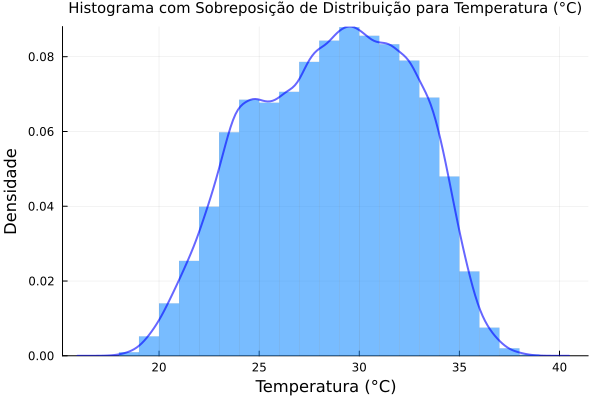

In [18]:
# Criando o histograma com a sobreposição da densidade
histogram(df.TEMPERATURA_AR_BULBO_SECO,
          bins=30,                # Número de bins
          normalize=true,         # Normaliza o histograma para densidade
          color=:dodgerblue,         # Cor das barras do histograma
          edgecolor=:black,       # Cor das bordas das barras
          xlabel="Temperatura (°C)",
          ylabel="Densidade",
          title="Histograma com Sobreposição de Distribuição para Temperatura (°C)",
          titlefontsize=10,       # Diminuindo o tamanho da fonte do título
          alpha=0.6,              # Transparência do histograma
          lw=0,
          legend=false)           # Sem legenda para o histograma

# Sobrepondo a densidade (curva de distribuição)
density!(df.TEMPERATURA_AR_BULBO_SECO,
         color=:blue,          # Cor da linha de densidade
         lw=2,            # Espessura da linha de densidade
         alpha=0.6)              # Transparência da curva de densidade


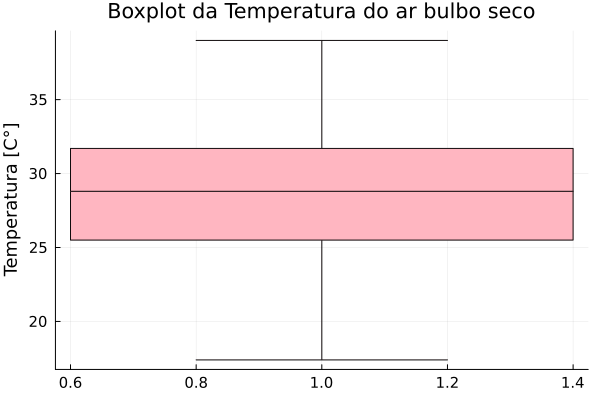

In [19]:
boxplot(df.TEMPERATURA_AR_BULBO_SECO,
        xlabel="", ylabel="Temperatura [C°]", title="Boxplot da Temperatura do ar bulbo seco",
        legend=false,  # Remover a legenda, já que só temos uma série de dados
        color=:lightpink,  # Cor das caixas
        boxwidth=0.3,  # Ajuste da largura das caixas
        whiskercolor=:black,  # Cor das linhas dos bigodes
        fliercolor=:red,  # Cor dos outliers
        fliermarker=:circle,  # Estilo dos marcadores dos outliers
        mediancolor=:black,  # Cor da linha da mediana
        medianwidth=3,  # Espessura da linha da mediana
        grid=true,  # Adicionar grid
        titlefontsize=14,  # Tamanho da fonte do título
        labelfontsize=12,  # Tamanho da fonte dos rótulos
        tickfontsize=10)  # Tamanho da fonte dos ticks

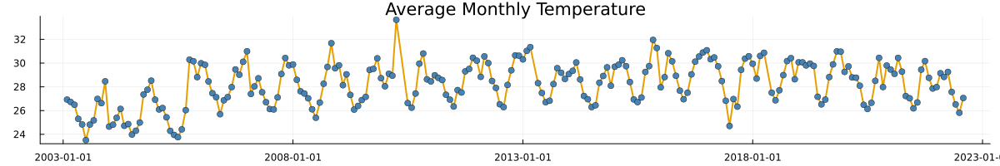

In [20]:
# Formatando as datas para extrair o mês e ano
df.MonthYear = Dates.format.(df.DATA, "yyyymm")

# Calculando a média de temperatura por mês
monthly_avg_temp = combine(groupby(df, :MonthYear), :TEMPERATURA_AR_BULBO_SECO => mean => :AvgTemperature)

# Convertendo MonthYear de volta para Date para plotagem adequada
monthly_avg_temp.MonthYear = Date.(monthly_avg_temp.MonthYear, "yyyymm")

# Criando o gráfico de linha com as médias mensais de temperatura
plot(
    monthly_avg_temp.MonthYear, monthly_avg_temp.AvgTemperature,
    xlabel = "Date", ylabel = "Average Temperature (°C)",
    title = "Average Monthly Temperature", 
    label = "Average Temp [°C]", legend = :none,
    lw = 2, markershape = :circle, markercolor = :steelblue,
    xrotation = 0,  # Rotacionando os rótulos do eixo X
    size = (1200, 200)  # Esticando o gráfico para os lados (largura maior)
)

In [21]:
# Formatando as datas para formato "jan 2013"
formatted_dates = [Dates.format(d, "u yyyy") for d in df.DATA];
# Extraindo as datas únicas de cada mês (por exemplo, pegando o primeiro dia de cada mês)
unique_months = unique(Dates.yearmonth.(df.DATA));
# Filtrando as datas para mostrar apenas uma por mês
tick_positions = [findfirst(x -> Dates.yearmonth(x) == month, df.DATA) for month in unique_months];

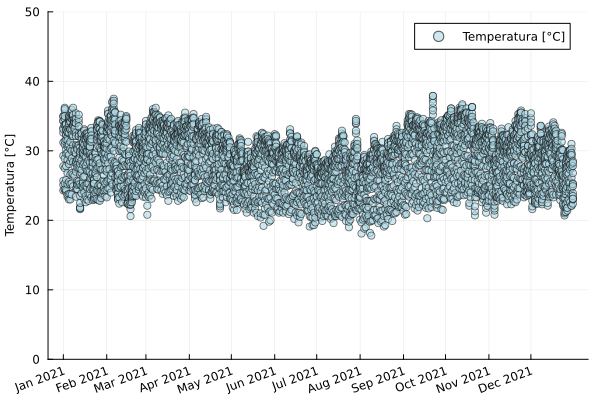

In [22]:
# Filtrando os dados para incluir apenas o ano de 2013
df_2021 = filter(row -> year(row.DATA) == 2021, df)

# Formatando as datas para o formato "jan 2013"
formatted_dates = [Dates.format(d, "u yyyy") for d in df_2021.DATA]

# Extraindo as datas únicas de cada mês para 2013 (por exemplo, pegando o primeiro dia de cada mês)
unique_months = unique(Dates.yearmonth.(df_2021.DATA))

# Filtrando as datas para mostrar apenas uma por mês
tick_positions = [findfirst(x -> Dates.yearmonth(x) == month, df_2021.DATA) for month in unique_months]

# Criando o gráfico com a escala de temperatura em Celsius
scatter(
    df_2021.DATA, df_2021.TEMPERATURA_AR_BULBO_SECO,
    label = "Temperatura [°C]",
    color = :lightblue, alpha = 0.6, xlabel = "", ylabel = "Temperatura [°C]", 
    legend = :topright,  # Adicionando a legenda
    legendfontsize = 8,  # Diminuindo o tamanho da fonte da legenda
    ylims = (0, 50),
    linewidth = 1.5,
    yticks = 0:10:50,  # Definindo ticks de 10 em 10 no eixo Y
    tickfontsize = 8,  # Diminuindo o tamanho da fonte dos ticks
    guidefontsize = 8,  # Diminuindo o tamanho das fontes dos rótulos
    xticks = (df_2021.DATA[tick_positions], formatted_dates[tick_positions]),  # Ajustando os rótulos e suas posições
    xrotation = 20  # Rotacionando os rótulos do eixo X em 45 graus
)

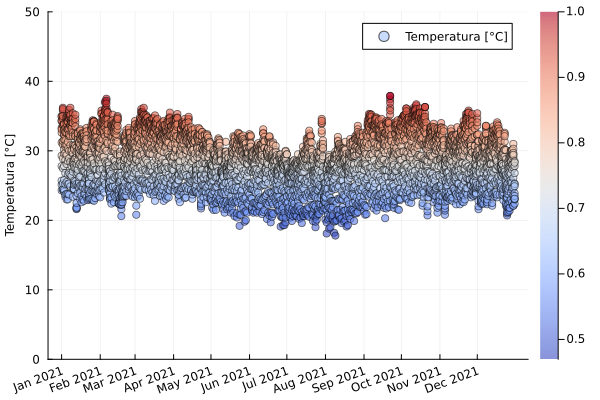

In [23]:
# Criando o gráfico com a escala de temperatura em Celsius
scatter(
    df_2021.DATA, df_2021.TEMPERATURA_AR_BULBO_SECO,
    label = "Temperatura [°C]",
    color=:coolwarm,
    zcolor=df_2021[!, :TEMPERATURA_AR_BULBO_SECO] ./ maximum(df_2021[!, :TEMPERATURA_AR_BULBO_SECO]),
    alpha = 0.6,
    xlabel = "",
    ylabel = "Temperatura [°C]", 
    legend = :topright,  # Adicionando a legenda
    legendfontsize = 8,  # Diminuindo o tamanho da fonte da legenda
    ylims = (0, 50),
    linewidth = 1.5,
    yticks = 0:10:50,  # Definindo ticks de 10 em 10 no eixo Y
    tickfontsize = 8,  # Diminuindo o tamanho da fonte dos ticks
    guidefontsize = 8,  # Diminuindo o tamanho das fontes dos rótulos
    xticks = (df_2021.DATA[tick_positions], formatted_dates[tick_positions]),  # Ajustando os rótulos e suas posições
    xrotation = 20  # Rotacionando os rótulos do eixo X em 45 graus
)

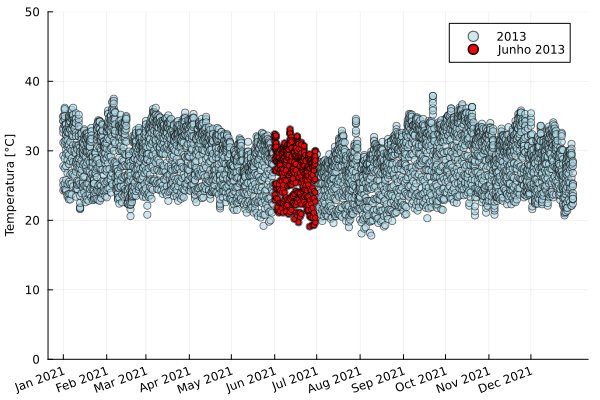

In [24]:
# Filtrando os dados para o mês de junho de 2013
junho_2021 = df_2021[month.(df_2021.DATA) .== 6, :]

# Criando o gráfico com a escala de temperatura em Celsius
p = scatter(
    df_2021.DATA, df_2021.TEMPERATURA_AR_BULBO_SECO,
    label = "2013",
    color = :lightblue, alpha = 0.6, xlabel = "", ylabel = "Temperatura [°C]", 
    legend = :topright,
    legendfontsize = 8,  # Diminuindo o tamanho da fonte da legenda
    ylims = (0, 50),
    linewidth = 1.5,
    yticks = 0:10:50,  # Definindo ticks de 10 em 10 no eixo Y
    tickfontsize = 8,  # Diminuindo o tamanho da fonte dos ticks
    guidefontsize = 8,   # Diminuindo o tamanho das fontes dos rótulos
    xticks = (df_2021.DATA[tick_positions], formatted_dates[tick_positions]),  # Ajustando os rótulos e suas posições
    xrotation = 20  # Rotacionando os rótulos do eixo X em 20 graus
)

# Adicionando os pontos de junho de 2013 em vermelho
scatter!(
    junho_2021.DATA, junho_2021.TEMPERATURA_AR_BULBO_SECO, 
    color = :red, label = "Junho 2013", markersize = 3
)

# Exibir o gráfico
display(p)

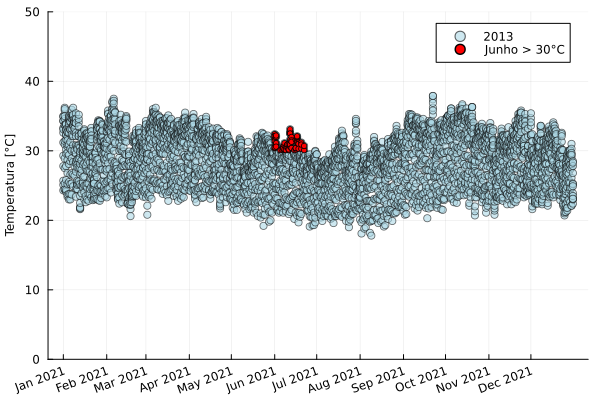

In [25]:
# Filtrando os dados para o mês de junho de 2013 com temperaturas maiores que 30°C
junho_maior_30_data = df_2021[(month.(df_2021.DATA) .== 6) .& (df_2021.TEMPERATURA_AR_BULBO_SECO .> 30), :]

# Criando o gráfico com a escala de temperatura em Celsius
p = scatter(
    df_2021.DATA, df_2021.TEMPERATURA_AR_BULBO_SECO,
    label = "2013",
    color = :lightblue, alpha = 0.6, xlabel = "", ylabel = "Temperatura [°C]", 
    legend = :topright,
    legendfontsize = 8,  # Diminuindo o tamanho da fonte da legenda
    ylims = (0, 50),
    linewidth = 1.5,
    yticks = 0:10:50,  # Definindo ticks de 10 em 10 no eixo Y
    tickfontsize = 8,  # Diminuindo o tamanho da fonte dos ticks
    guidefontsize = 8,   # Diminuindo o tamanho das fontes dos rótulos
    xticks = (df_2021.DATA[tick_positions], formatted_dates[tick_positions]),  # Ajustando os rótulos e suas posições
    xrotation = 20  # Rotacionando os rótulos do eixo X em 20 graus
)

# Adicionando os pontos de junho de 2013 com temperatura > 30°C em vermelho
scatter!(
    junho_maior_30_data.DATA, junho_maior_30_data.TEMPERATURA_AR_BULBO_SECO, 
    color = :red, label = "Junho > 30°C", markersize = 3
)

# Exibir o gráfico
display(p)

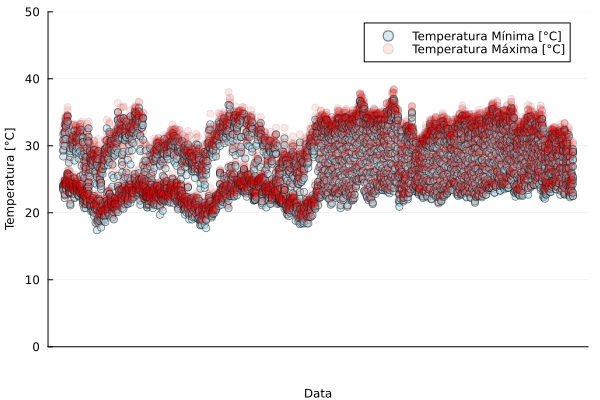

In [26]:
# Criando o gráfico de dispersão para as duas variáveis de temperatura
scatter(
    df_2021.DATA, df.TEMPERATURA_MINIMA,
    label = "Temperatura Mínima [°C]",
    color = :lightblue, alpha = 0.5, xlabel = "Data", ylabel = "Temperatura [°C]",
    legend = :topright,
    legendfontsize = 8,  # Diminuindo o tamanho da fonte da legenda
    ylims = (0, 50),
    linewidth = 1.5,
    yticks = 0:10:50,  # Definindo ticks de 10 em 10 no eixo Y
    tickfontsize = 8,  # Diminuindo o tamanho da fonte dos ticks
    guidefontsize = 8,   # Diminuindo o tamanho das fontes dos rótulos
    xticks = (df.DATA[tick_positions], formatted_dates[tick_positions]),  # Ajustando os rótulos e suas posições
    xrotation = 20  # Rotacionando os rótulos do eixo X em 45 graus
)

scatter!(
    df_2021.DATA, df.TEMPERATURA_MAXIMA,
    label = "Temperatura Máxima [°C]",
    color = :red, alpha = 0.1,
    linewidth = 1.5
)

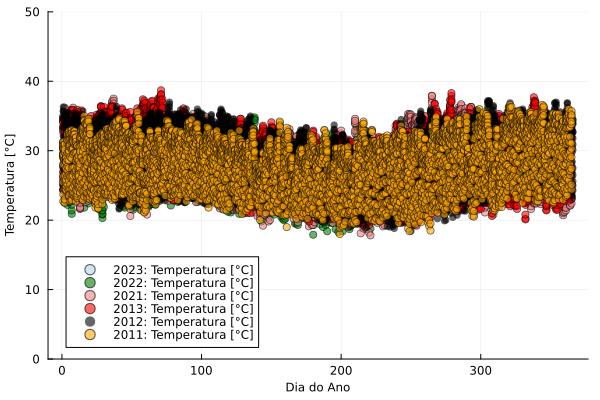

In [27]:
# Supondo que 'df' seja o DataFrame que contém os dados de vários anos
# Primeiramente, vamos adicionar uma coluna com o ano extraído da coluna 'DATA'
df.Ano = year.(df.DATA)

# Definir os anos, rótulos e cores
dados = [
    (ano = 2023, cor = :lightblue, label = "2023: Temperatura [°C]"),
    (ano = 2022, cor = :green, label = "2022: Temperatura [°C]"),
    (ano = 2021, cor = :lightcoral, label = "2021: Temperatura [°C]"),
    (ano = 2013, cor = :red, label = "2013: Temperatura [°C]"),
    (ano = 2012, cor = :black, label = "2012: Temperatura [°C]"),
    (ano = 2011, cor = :orange, label = "2011: Temperatura [°C]")
]

# Inicializar o gráfico
p = scatter(
    dayofyear.(df[df.Ano .== 2023, :DATA]), df[df.Ano .== 2023, :TEMPERATURA_AR_BULBO_SECO],
    label = "2023: Temperatura [°C]",
    color = :lightblue, alpha = 0.6, xlabel = "Dia do Ano", ylabel = "Temperatura [°C]", 
    legend = :bottomleft, legendfontsize = 8,
    ylims = (0, 50), linewidth = 1.5, yticks = 0:10:50, 
    tickfontsize = 8, guidefontsize = 8
)

# Adicionar os dados dos outros anos usando um loop
for (ano, cor, label) in dados[2:end]
    scatter!(
        dayofyear.(df[df.Ano .== ano, :DATA]), df[df.Ano .== ano, :TEMPERATURA_AR_BULBO_SECO],
        label = label,
        color = cor, alpha = 0.6, linewidth = 1.5
    )
end

# Exibir o gráfico
display(p)

In [28]:
# Ordenar as 5 temperaturas mais altas (TEMPERATURA_MAXIMA)
top_5_quentes = sort(df, :TEMPERATURA_MAXIMA, rev=true)[1:10, [:DATA, :TEMPERATURA_MAXIMA]]

Row,DATA,TEMPERATURA_MAXIMA
,Date,Float64
1,2018-06-29,40.7
2,2019-11-24,40.1
3,2019-11-24,39.6
4,2016-12-06,39.3
5,2017-11-12,39.3
6,2019-12-03,39.3
7,2017-11-12,39.2
8,2013-03-12,39.1
9,2019-11-24,39.1


In [29]:
# Ordenar as 5 temperaturas mais baixas (TEMPERATURA_MINIMA)
top_5_frias = sort(df, :TEMPERATURA_MINIMA)[1:10, [:DATA, :TEMPERATURA_MINIMA]]

Row,DATA,TEMPERATURA_MINIMA
,Date,Float64
1,2007-08-18,17.3
2,2010-08-20,17.3
3,2017-07-14,17.3
4,2003-07-05,17.4
5,2006-09-02,17.4
6,2006-09-02,17.4
7,2010-08-21,17.5
8,2021-08-09,17.6
9,2004-08-14,17.7


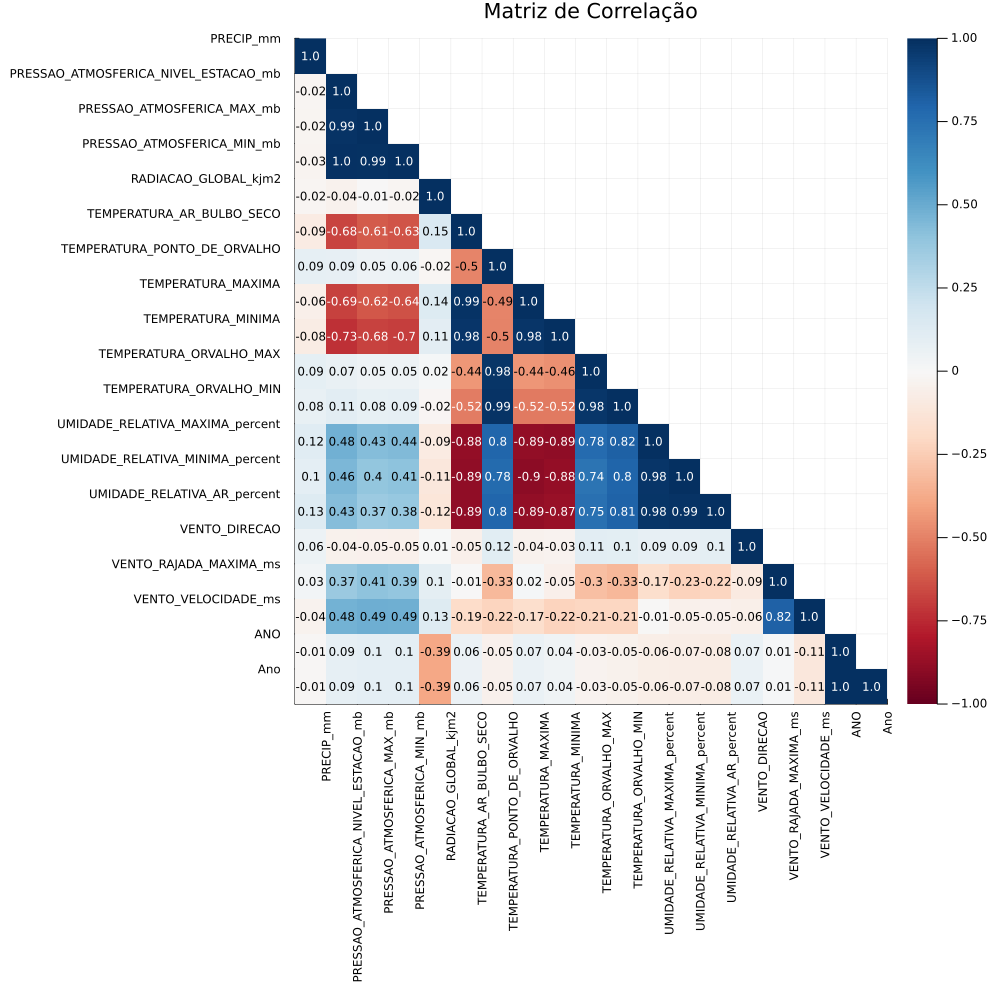

In [30]:
# Selecionar apenas colunas numéricas
numeric_df = df[:, [col for col in names(df) if eltype(df[!, col]) <: Number]]

# Calcular matriz de correlação
cor_matrix = cor(Matrix(numeric_df))
n_vars = size(cor_matrix, 1)
var_names = names(numeric_df)

# Criar máscara triangular inferior
mask = [i >= j for i in 1:n_vars, j in 1:n_vars]

# Aplicar máscara: valores fora do triângulo ficam como NaN
masked_cor = cor_matrix .* mask
masked_cor[.!mask] .= NaN

# Inverter as linhas da matriz para alinhar com os nomes invertidos no eixo Y
reversed_masked_cor = reverse(masked_cor, dims=1)
reversed_names = reverse(var_names)

# Criar heatmap
plt = heatmap(
    var_names, reversed_names,  # Eixos com nomes originais e invertidos
    reversed_masked_cor,        # Matriz invertida verticalmente
    color = :RdBu, clims = (-1, 1),
    xrot = 90, size = (1000, 1000),
    colorbar_title = "",
    title = "Matriz de Correlação",
    xticks = (1:n_vars, var_names),  # Forçar todos os ticks no eixo X
    yticks = (1:n_vars, reversed_names)  # Forçar todos os ticks no eixo Y
)

# Adicionar anotações nas posições corretas (considerando a inversão vertical)
for i in 1:n_vars
    for j in 1:i  # Apenas triângulo inferior
        value = round(cor_matrix[i, j], digits=2)
        text_color = abs(value) > 0.5 ? :white : :black
        # Posição X: coluna j, Posição Y: linha ajustada pela inversão
        annotate!(plt, j - 0.5, n_vars - i + 0.5, text("$value", 8, text_color, :center))
    end
end

display(plt)

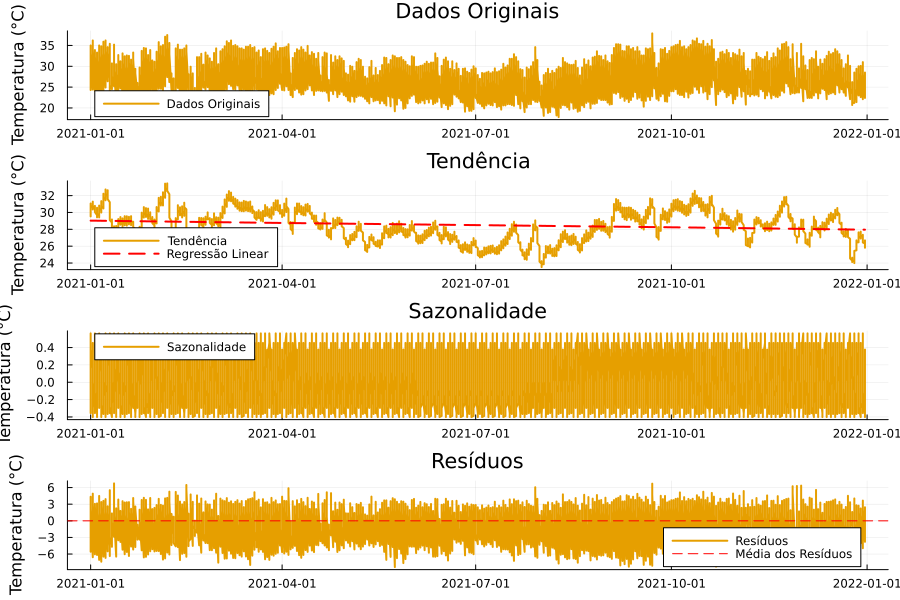

In [31]:
using TimeSeries
# Passo 1: Criar uma série temporal com os dados de temperatura usando TimeArray
temperature_ts = TimeArray(df_2021.DATA, df_2021.TEMPERATURA_AR_BULBO_SECO)

# Passo 2: Calcular a tendência usando uma média móvel
# Vamos usar uma janela de 30 dias para a média móvel (ajuste conforme necessário)
window_size = 30
trend_values = [mean(values(temperature_ts)[max(1, i - window_size ÷ 2):min(end, i + window_size ÷ 2)]) for i in 1:length(temperature_ts)]
trend = TimeArray(timestamp(temperature_ts), trend_values)

# Passo 3: Ajustar um modelo de regressão linear à tendência
# Criar um DataFrame com os dados da tendência para usar no GLM
trend_df = DataFrame(DATA = timestamp(trend), Tendencia = values(trend))
trend_df.time_index = 1:nrow(trend_df)  # Adicionar um índice de tempo para a regressão

# Ajustar o modelo de regressão linear
model = lm(@formula(Tendencia ~ time_index), trend_df)

# Passo 4: Prever os valores da linha de regressão
trend_df.regression = predict(model)

# Passo 5: Remover a tendência dos dados originais para obter a componente sazonal e residual
detrended_values = values(temperature_ts) - values(trend)
detrended = TimeArray(timestamp(temperature_ts), detrended_values)

# Passo 6: Calcular a sazonalidade (assumindo um período sazonal fixo, por exemplo, 30 dias)
period = 30
seasonal_values = zeros(length(temperature_ts))
for i in 1:period
    idx = i:period:length(temperature_ts)  # Índices correspondentes ao mesmo ponto no período
    seasonal_values[idx] .= mean(values(detrended)[idx])  # Média dos valores correspondentes
end
seasonal = TimeArray(timestamp(temperature_ts), seasonal_values)

# Passo 7: Calcular os resíduos
residual_values = values(detrended) - values(seasonal)
residual = TimeArray(timestamp(temperature_ts), residual_values)

# Passo 8: Visualizar a decomposição em um layout com 4 subplots
# Criar os subplots
p1 = plot(timestamp(temperature_ts), values(temperature_ts), label = "Dados Originais", lw = 2, title = "Dados Originais", xlabel = "", ylabel = "Temperatura (°C)")
p2 = plot(timestamp(trend), values(trend), label = "Tendência", lw = 2, title = "Tendência", xlabel = "", ylabel = "Temperatura (°C)")
plot!(p2, timestamp(trend), trend_df.regression, label = "Regressão Linear", lw = 2, linestyle = :dash, linecolor = :red)  # Adicionar a linha de regressão
p3 = plot(timestamp(temperature_ts), values(seasonal), label = "Sazonalidade", lw = 2, title = "Sazonalidade", xlabel = "", ylabel = "Temperatura (°C)")
p4 = plot(timestamp(temperature_ts), values(residual), label = "Resíduos", lw = 2, title = "Resíduos", xlabel = "", ylabel = "Temperatura (°C)")

# Adicionar uma linha horizontal no gráfico dos resíduos para representar a média dos resíduos
mean_residual = mean(values(residual))  # Média dos resíduos
hline!(p4, [mean_residual], label = "Média dos Resíduos", linestyle = :dash, linecolor = :red)

# Exibir todos os subplots em um layout
plot(p1, p2, p3, p4, layout = (4, 1), size = (900, 600))

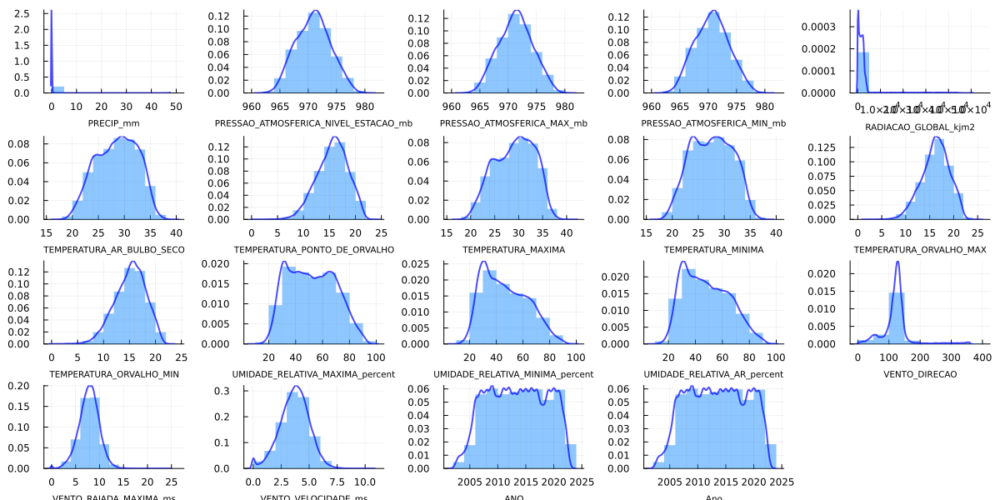

In [32]:
# Gerar histogramas para cada coluna e armazenar os gráficos em um vetor
plots = []
for col in names(numeric_df)
    # Remover valores missing ou NaN da coluna usando skipmissing
    clean_data = collect(skipmissing(numeric_df[!, col]))
    
    # Criar histograma normalizado (com density=true)
    p = histogram(clean_data, 
                  xlabel=col, 
                  legend=:none,
                  size=(300, 200),
                  color=:dodgerblue,         # Cor personalizada
                  linewidth=0,
                  alpha=0.5,
                  nbins=15,
                  normalize=:pdf,
                  xguidefontsize=7)     # Diminuir o tamanho da fonte do xlabel)         # Normalizar o histograma para probabilidade (pdf)
    
    # Adicionar densidade
    density!(p, clean_data, 
             color=:blue,          # Cor da linha de densidade
             linewidth=2,         # Espessura da linha de densidade
             alpha=0.7)           # Transparência da curva de densidade

    # Adicionar o gráfico ao vetor
    push!(plots, p)
end

# Organizar os gráficos em subplots
plot(plots..., layout=(4, 5), size=(1200, 600))

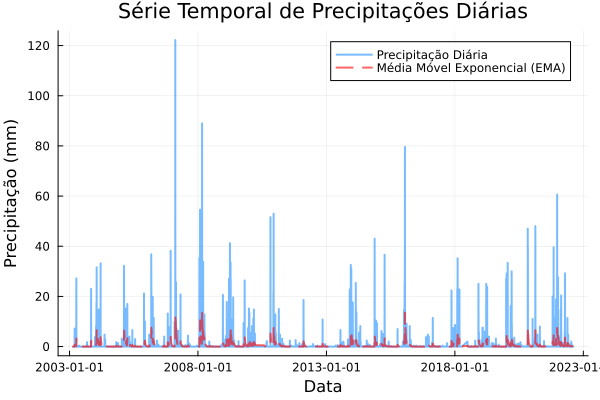

In [33]:
# Agrupar por dia para obter a precipitação total diária
df_daily = combine(groupby(df, :DATA), :PRECIP_mm => sum => :Precipitação_Diária)

# Ordenar o DataFrame por data (caso não esteja ordenado)
sort!(df_daily, :DATA)

# Calcular a média móvel exponencial (EMA) com um fator de suavização
function ema(values, α=0.1)
    ema_values = similar(values)
    ema_values[1] = values[1]
    for i in 2:length(values)
        ema_values[i] = α * values[i] + (1 - α) * ema_values[i-1]
    end
    return ema_values
end

# Calcular a EMA para a precipitação diária
α = 0.1  # Fator de suavização (ajuste conforme necessário)
df_daily[!, :EMA_Precipitação] = ema(df_daily[!, :Precipitação_Diária], α)

# Plotar a série temporal com a linha de média ponderada (EMA)
plot(df_daily[!, :DATA], df_daily[!, :Precipitação_Diária], 
    title="Série Temporal de Precipitações Diárias", 
    xlabel="Data", ylabel="Precipitação (mm)", 
    label="Precipitação Diária", lw=2, color=:dodgerblue, seriestype=:line, alpha=0.6)

plot!(df_daily[!, :DATA], df_daily[!, :EMA_Precipitação], 
    label="Média Móvel Exponencial (EMA)", lw=2, color=:red, linestyle=:dash, alpha=0.6)

# Melhorar a legenda e o layout
plot!(legend=:topright, grid=true)

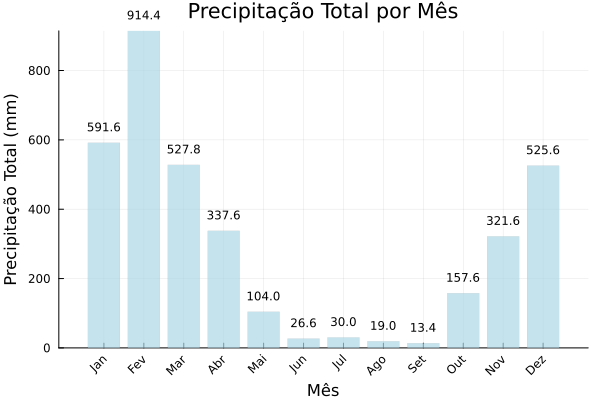

In [34]:
# Extrair o mês da coluna DATA
df[!, :MES] = month.(df[!, :DATA])

# Agrupar por mês e somar a precipitação
df_monthly_precip = combine(groupby(df, :MES), :PRECIP_mm => sum => :Precipitação_Total)

# Ordenar os meses pela precipitação total (do maior para o menor)
sort!(df_monthly_precip, :Precipitação_Total, rev=true)

# Criar o gráfico de barras
bar(df_monthly_precip.MES, 
    df_monthly_precip.Precipitação_Total, 
    xlabel="Mês", 
    ylabel="Precipitação Total (mm)", 
    title="Precipitação Total por Mês", 
    legend=false, 
    color=:lightblue, 
    alpha=0.7,
    lw=0,
    xticks=(1:12, ["Jan", "Fev", "Mar", "Abr", "Mai", "Jun", "Jul", "Ago", "Set", "Out", "Nov", "Dez"]),  # Nomes dos meses
    xrotation=45)  # Rotacionar os rótulos do eixo x para melhor legibilidade

# Adicionar os valores em cima de cada barra (com 2 dígitos)
for (i, precip) in enumerate(df_monthly_precip.Precipitação_Total)
    precip_formatado = round(precip, digits=2)  # Arredonda para 2 dígitos
    annotate!(df_monthly_precip.MES[i], precip + 0.05 * maximum(df_monthly_precip.Precipitação_Total), 
              text("$precip_formatado", :center, 8))  # Adiciona o valor formatado acima da barra
end

# Exibir o gráfico
plot!()

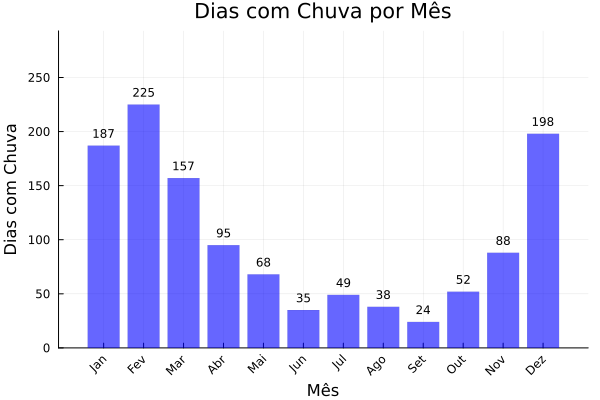

In [35]:
# Filtrar apenas os dias com precipitação maior que 0
df_chuva = filter(row -> row.PRECIP_mm > 0, df)

# Agrupar por mês e contar o número de dias com chuva
df_chuva_mensal = combine(groupby(df_chuva, :MES), nrow => :Dias_Com_Chuva)

# Ordenar os meses pelo número de dias com chuva (do maior para o menor)
sort!(df_chuva_mensal, :Dias_Com_Chuva, rev=true)

# Criar o gráfico de barras
bar(df_chuva_mensal.MES, 
    df_chuva_mensal.Dias_Com_Chuva, 
    xlabel="Mês", 
    ylabel="Dias com Chuva", 
    title="Dias com Chuva por Mês", 
    legend=false, 
    color=:blue, 
    alpha=0.6,
    lw=0,
    xticks=(1:12, ["Jan", "Fev", "Mar", "Abr", "Mai", "Jun", "Jul", "Ago", "Set", "Out", "Nov", "Dez"]),  # Nomes dos meses
    ylim=(0, maximum(contagem_por_ano.QUANTIDADE) * 0.06),  # Ajustar o limite superior do eixo y
    xrotation=45)  # Rotacionar os rótulos do eixo x para melhor legibilidade

# Adicionar os valores em cima de cada barra
for (i, dias) in enumerate(df_chuva_mensal.Dias_Com_Chuva)
    annotate!(df_chuva_mensal.MES[i], dias + 0.05 * maximum(df_chuva_mensal.Dias_Com_Chuva), 
              text("$dias", :center, 8))  # Adicionar o valor acima da barra
end

# Exibir o gráfico
plot!()

In [36]:
# Passo 1: Extrair o dia e o mês da coluna DATA
df[!, :DIA] = day.(df[!, :DATA])
df[!, :MES] = month.(df[!, :DATA])

# Passo 2: Filtrar apenas os dias 23/02
df_23_02 = filter(row -> row.DIA == 23 && row.MES == 2, df)

# Passo 3: Filtrar apenas os dias com precipitação maior que 0
df_23_02_chuva = filter(row -> row.PRECIP_mm > 0, df_23_02)

Row,DATA,HORA,PRECIP_mm,PRESSAO_ATMOSFERICA_NIVEL_ESTACAO_mb,PRESSAO_ATMOSFERICA_MAX_mb,PRESSAO_ATMOSFERICA_MIN_mb,RADIACAO_GLOBAL_kjm2,TEMPERATURA_AR_BULBO_SECO,TEMPERATURA_PONTO_DE_ORVALHO,TEMPERATURA_MAXIMA,TEMPERATURA_MINIMA,TEMPERATURA_ORVALHO_MAX,TEMPERATURA_ORVALHO_MIN,UMIDADE_RELATIVA_MAXIMA_percent,UMIDADE_RELATIVA_MINIMA_percent,UMIDADE_RELATIVA_AR_percent,VENTO_DIRECAO,VENTO_RAJADA_MAXIMA_ms,VENTO_VELOCIDADE_ms,ANO,MonthYear,Ano,MES,DIA
,Date,Any,Float64,Float64,Float64,Float64,Real,Float64,Float64,Float64,Float64,Float64,Float64,Int64,Int64,Int64,Int64,Float64,Float64,Int64,String,Int64,Int64,Int64
1,2007-02-23,21:00:00,25.6,971.5,972.1,970.8,789.0,22.3,20.9,25.5,21.1,21.3,19.4,93,73,92,17,15.1,3.3,2007,200702,2007,2,23
2,2009-02-23,21:00:00,0.4,968.8,968.8,967.1,149.2,24.6,19.8,28.7,24.6,20.7,18.5,77,56,75,39,9.7,4.6,2009,200902,2009,2,23
3,2009-02-23,23:00:00,4.2,971.6,971.6,969.5,0.8,21.2,19.1,23.7,21.1,20.0,18.9,88,77,88,34,13.8,6.3,2009,200902,2009,2,23
4,2015-02-23,19:00:00,0.2,967.6,968.5,967.6,1463.1,29.3,19.6,29.8,26.6,21.2,19.1,72,55,56,152,9.4,3.2,2015,201502,2015,2,23
5,2015-02-23,21:00:00,3.4,969.9,970.0,968.0,143.8,21.8,19.3,29.7,21.7,20.0,18.6,86,52,86,160,14.3,4.3,2015,201502,2015,2,23
6,2018-02-23,14:00:00,1.0,972.0,972.2,971.8,344.5,25.0,20.4,26.9,25.0,20.7,19.8,76,67,76,299,6.2,1.6,2018,201802,2018,2,23
7,2018-02-23,15:00:00,2.0,971.3,972.2,971.2,505.7,25.2,22.3,25.2,23.7,22.3,20.5,85,76,84,299,4.7,1.0,2018,201802,2018,2,23


In [37]:
# Agrupar por mês e encontrar o dia com a maior precipitação
df_max_chuva_mensal = combine(groupby(df, :MES), :PRECIP_mm => maximum => :Max_Precipitação)

# Juntar os dados originais para obter as datas correspondentes aos máximos
df_resultado = innerjoin(df, df_max_chuva_mensal, on=[:MES, :PRECIP_mm => :Max_Precipitação])

# Selecionar apenas as colunas relevantes (DATA, MES, PRECIP_mm)
df_resultado = df_resultado[:, [:DATA, :MES, :PRECIP_mm]]

# Ordenar os resultados por mês
sort!(df_resultado, :MES)

Row,DATA,MES,PRECIP_mm
,Date,Int64,Float64
1,2008-01-31,1,47.4
2,2007-02-13,2,47.0
3,2008-03-15,3,33.8
4,2003-04-08,4,27.2
5,2009-05-16,5,19.6
6,2005-06-12,6,6.2
7,2013-07-19,7,6.2
8,2019-08-07,8,2.2
9,2006-09-08,9,2.6


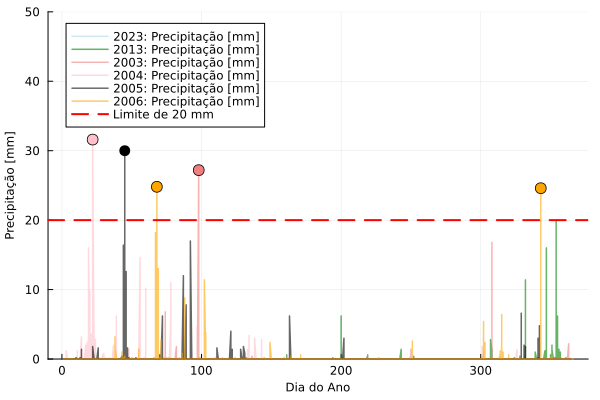

In [38]:
using Plots

# Definir os anos, rótulos e cores
dados = [
    (ano = 2023, cor = :lightblue, label = "2023: Precipitação [mm]"),
    (ano = 2013, cor = :green, label = "2013: Precipitação [mm]"),
    (ano = 2003, cor = :lightcoral, label = "2003: Precipitação [mm]"),
    (ano = 2004, cor = :pink, label = "2004: Precipitação [mm]"),
    (ano = 2005, cor = :black, label = "2005: Precipitação [mm]"),
    (ano = 2006, cor = :orange, label = "2006: Precipitação [mm]")
]

# Inicializar o gráfico
p = plot(
    dayofyear.(df[df.Ano .== 2023, :DATA]), df[df.Ano .== 2023, :PRECIP_mm],
    label = "2023: Precipitação [mm]",
    color = :lightblue, alpha = 0.6, xlabel = "Dia do Ano", ylabel = "Precipitação [mm]", 
    legend = :topleft, legendfontsize = 8,
    ylims = (0, 50), linewidth = 1.5, yticks = 0:10:50, 
    tickfontsize = 8, guidefontsize = 8
)

# Adicionar os dados dos outros anos usando um loop
for (ano, cor, label) in dados[2:end]
    plot!(
        dayofyear.(df[df.Ano .== ano, :DATA]), df[df.Ano .== ano, :PRECIP_mm],
        label = label,
        color = cor, alpha = 0.6, linewidth = 1.5
    )
end

# Adicionar uma linha horizontal em 30 mm para destacar os dias com chuva intensa
hline!([20], color = :red, linestyle = :dash, label = "Limite de 20 mm", linewidth = 2)

# Destacar os pontos onde a precipitação foi maior que 30 mm
for (ano, cor, label) in dados
    dias_chuva_intensa = dayofyear.(df[(df.Ano .== ano) .& (df.PRECIP_mm .> 20), :DATA])
    precip_chuva_intensa = df[(df.Ano .== ano) .& (df.PRECIP_mm .> 20), :PRECIP_mm]
    scatter!(
        dias_chuva_intensa, precip_chuva_intensa,
        color = cor, markersize = 6, label = nothing, markerstrokecolor = :black
    )
end

# Exibir o gráfico
display(p)

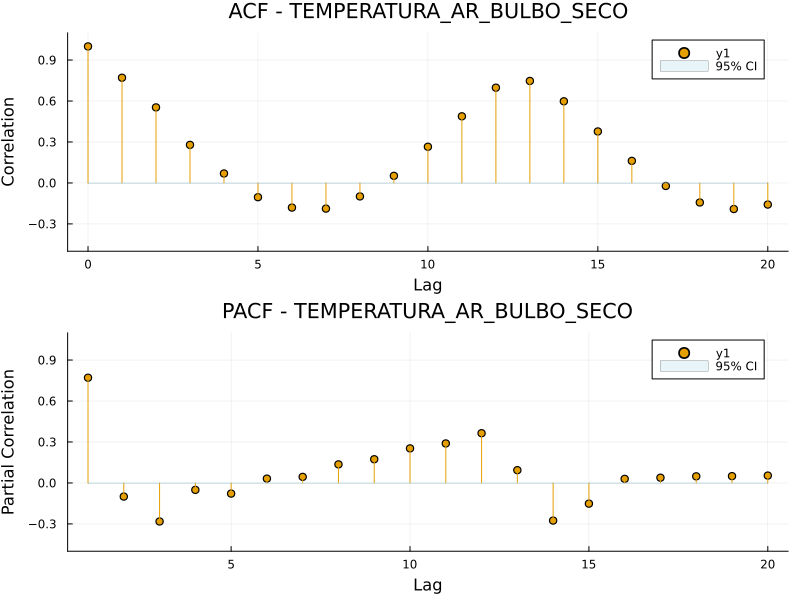

In [57]:
# Suponha que `df` seja o seu DataFrame e `TEMPERATURA_AR_BULBO_SECO` seja a variável escolhida
x = df.TEMPERATURA_AR_BULBO_SECO

max_lag = 20

# Calcular ACF e PACF
acf_values = autocor(x, 0:max_lag)
pacf_values = pacf(x, 1:max_lag)

# Calcular intervalo de confiança 95%
conf = 1.96 / sqrt(length(x))

# Função para adicionar o sombreamento (sem borda)
function add_confidence_band!(plot, lags, conf)
    x_min = minimum(lags)
    x_max = maximum(lags)
    plot!(
        plot,
        [x_min, x_max, x_max, x_min, x_min],
        [conf, conf, -conf, -conf, conf],
        seriestype=:shape,
        fillcolor=:lightblue,
        fillalpha=0.3,
        linewidth=0,  # Removemos a borda aqui
        label="95% CI"
    )
end

# Plot ACF
p1 = plot(0:max_lag, acf_values,
    seriestype=:stem,
    title="ACF - TEMPERATURA_AR_BULBO_SECO",
    xlabel="Lag",
    ylabel="Correlation",
    markershape=:circle,
    ylim=(-0.5, 1.1),
    legend=:topright
)
add_confidence_band!(p1, 0:max_lag, conf)

# Plot PACF
p2 = plot(1:max_lag, pacf_values,
    seriestype=:stem,
    title="PACF - TEMPERATURA_AR_BULBO_SECO",
    xlabel="Lag",
    ylabel="Partial Correlation",
    markershape=:circle,
    ylim=(-0.5, 1.1),
    legend=:topright
)
add_confidence_band!(p2, 1:max_lag, conf)

# Combinar plots
plot(p1, p2, layout=(2, 1), size=(800, 600))

O gráfico mostra duas representações de funções de autocorrelação (ACF) e autocorrelação parcial (PACF) para a variável TEMPERATURA_AR_BULBO_SECO ao longo de diferentes lags.

1. **ACF (Autocorrelação)**
- **Parte superior do gráfico**: Exibe como a variável está correlacionada consigo mesma em diferentes defasagens (lags). Cada ponto representa o valor da correlação entre o valor da variável em um determinado momento e o valor em um número específico de lags anteriores.

- **Interpretação dos resultados**: Valores de correlação próximos a `1` ou `-1` indicam uma forte correlação positiva ou negativa, respectivamente, entre os valores defasados.
No gráfico ACF, há uma correlação significativa nos primeiros `lags (0 a 5)` e em torno de `lags maiores (aproximadamente 15)`, o que indica que há padrões de dependência nos dados ao longo dessas defasagens.

- As barras verticais indicam intervalos de confiança de 95%. Quando a correlação está fora desses limites, considera-se estatisticamente significativa.

2. **PACF (Autocorrelação Parcial)**
- **Parte inferior do gráfico**: Mostra as correlações parciais, ou seja, a correlação da variável com seus próprios valores defasados, mas controlando para os lags intermediários. Isso elimina os efeitos indiretos de outros lags.

- **Interpretação dos resultados**: Se houver um padrão de decaimento lento ou picos em lags específicos, isso pode indicar dependências sazonais ou outras formas de correlação nos dados.
Os valores de PACF são significativos em torno de `1` a `2 lags` e entre `10` e `15 lags`, sugerindo que, após esses lags, há uma influência direta mais forte.

>Conclusão:
Esses resultados indicam que a temperatura do ar no bulbo seco apresenta autocorrelação significativa em alguns lags, sugerindo a presença de padrões de dependência temporal. Isso é útil, por exemplo, na modelagem de séries temporais (como modelos ARIMA), onde os lags significativos podem ser usados para prever os próximos valores com base nos anteriores.